# Determining the Best Location for a New High School in North Yorkshire, UK
## Applied Data Science Capstone by IBM/Coursera

## Table of Contents

* [Introduction: Business Problem](#introduction)
* [Data](#data)
* [Methodology](#methodology)
* [Analysis](#analysis)
* [Results and Discussion](#results)
* [Conclusion](#conclusion)

## Introduction: Business Problem <a name="introduction"></a>

The population of the UK, and North Yorkshire region is steadily growing, resulting in an increased need for high school places in the region. As most high schools in the region are already near capacity, it is unlikely that current education provision will be sufficient. North Yorkshire County Council needs to consider the increased requirement for high school places in the next few years, and determine the best location to site a new high school.

We will look for **locations where there is not already an existing school**, where the **current capacity is most strained**, and a location that would **result in a reduction in travelling distance for a significant number of students**.

Although North Yorkshire County Council are the main stakeholder, this problem may also be of interest to families looking to move to the region.



## Data <a name="data"></a>

Based on the problem defined above, factors that will impact our decision will include:
- **Population distribution** within the region
- The **locations** of existing high schools
- The current **capacity situation** of existing high schools
- The **average distance** children must travel to their nearest high school

The following data sources will be required:
- Geographic data on North Yorkshire administrative areas obtained from **Doogal**
- School location data will be obtained using **Foursquare API**
- School capactiy data obtained from the **British Government, Department of Education**
- Population distribution obtained from **North Yorkshire County Council Data Hub**


For data source references, please see the full project report.

Firstly, we will import and clean all of the relevant data.

### Data Aquistion & Cleaning

### Population Distribution:

In [44]:
# The code was removed by Watson Studio for sharing.

In [45]:
# Importing all required libraries

import types
import pandas as pd
from botocore.client import Config
import ibm_boto3
import requests
from pandas import json_normalize
import seaborn as sns
import numpy as np

! pip install folium
import folium
from folium import plugins
from folium.plugins import HeatMap

! pip install geopy
from geopy.geocoders import Nominatim

%matplotlib inline 

import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.style.use('ggplot')

In [46]:
# The code was removed by Watson Studio for sharing.

First, we will import the data on population distribution from the Doogal CSV file.

In [47]:
def __iter__(self): return 0
body = client_43aff0baa16c48e8a5a93efb1b8b23f4.get_object(Bucket='couseram2w3project-donotdelete-pr-umdypudkj036eb',Key='Yorkshire and The Humber postcodes.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

LSOA = pd.read_csv(body)
LSOA.head()

/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3063: DtypeWarning: Columns (18,29,47) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,Postcode,In Use?,Latitude,Longitude,Easting,Northing,Grid Ref,County,District,Ward,...,Nearest station,Distance to station,Postcode area,Postcode district,Police force,Water company,Plus Code,Average Income,Sewage Company,Travel To Work Area
0,BB18 6JR,Yes,53.922823,-2.122423,392058,447416,SD920474,North Yorkshire,Craven,West Craven,...,Gargrave,6.27990,BB,BB18,North Yorkshire,NaN,9C5VWVFH+42,43500,NaN,Skipton
1,BB18 6LB,Yes,53.919369,-2.120719,392169,447032,SD921470,North Yorkshire,Craven,West Craven,...,Gargrave,6.63985,BB,BB18,North Yorkshire,NaN,9C5VWV9H+PP,43500,NaN,Skipton
2,BB18 6LG,No,53.912668,-2.106466,393104,446285,SD931462,North Yorkshire,Craven,West Craven,...,Cononley,6.20213,BB,BB18,North Yorkshire,NaN,9C5VWV7V+3C,43500,NaN,Skipton
3,BB8 6JR,No,53.925680,-2.118773,392298,447734,SD922477,North Yorkshire,Craven,West Craven,...,Gargrave,5.92738,BB,BB8,North Yorkshire,NaN,9C5VWVGJ+7F,43500,NaN,Skipton
4,BB8 6LB,No,53.919369,-2.120719,392169,447032,SD921470,North Yorkshire,Craven,West Craven,...,Gargrave,6.63985,BB,BB8,North Yorkshire,NaN,9C5VWV9H+PP,43500,NaN,Skipton


We will then drop all postcodes postcodes that are no longer in use, select only the columns of interest and restrict the data to the county of North Yorkshire.

In [48]:
LSOA_act = LSOA.drop(LSOA[LSOA['In Use?'] == 'No'].index)

In [49]:
LSOA_req = LSOA_act[['Postcode', 'Latitude', 'Longitude','County','District','Ward','Constituency','LSOA Code','Lower layer super output area','Rural/urban','MSOA Code','Middle layer super output area']].reset_index(drop=True)
NY_only = LSOA_req[LSOA_req.County == 'North Yorkshire'].reset_index(drop=True)
NY_only.head()

,Postcode,Latitude,Longitude,County,District,Ward,Constituency,LSOA Code,Lower layer super output area,Rural/urban,MSOA Code,Middle layer super output area
0,BB18 6JR,53.922823,-2.122423,North Yorkshire,Craven,West Craven,Skipton and Ripon,E01027586,Craven 007D,Rural village,E02005748,"Carleton, Cowling & Cononley"
1,BB18 6LB,53.919369,-2.120719,North Yorkshire,Craven,West Craven,Skipton and Ripon,E01027586,Craven 007D,Rural village,E02005748,"Carleton, Cowling & Cononley"
2,BD20 7AA,53.905493,-1.981519,North Yorkshire,Craven,Glusburn,Skipton and Ripon,E01027565,Craven 008C,Urban city and town,E02005749,Sutton & Crosshills
3,BD20 7AD,53.903825,-1.981486,North Yorkshire,Craven,Glusburn,Skipton and Ripon,E01027565,Craven 008C,Urban city and town,E02005749,Sutton & Crosshills
4,BD20 7AE,53.892592,-1.992006,North Yorkshire,Craven,Sutton-in-Craven,Skipton and Ripon,E01027584,Craven 008F,Urban city and town,E02005749,Sutton & Crosshills


Population data is not available at postode level, but is available at LSOA level, therefore we will calculate the average latitude/longitude of an LSOA, by using the mean of the postcodes. We will also merge to get all relevant data.

In [50]:
NY_grouped = NY_only.groupby('LSOA Code').mean().reset_index()
NY = pd.merge(left=NY_grouped, right=NY_only[['LSOA Code','Lower layer super output area','MSOA Code','Middle layer super output area']], how='left', left_on='LSOA Code', right_on='LSOA Code').drop_duplicates().reset_index(drop=True)
NY = NY.rename(columns={'Lower layer super output area' : 'LSOA Name', 'Middle layer super output area' : 'MSOA Name'})
NY.head()

,LSOA Code,Latitude,Longitude,LSOA Name,MSOA Code,MSOA Name
0,E01013335,53.961965,-1.128547,York 012A,E02002783,Acomb
1,E01013336,53.957848,-1.128970,York 012B,E02002783,Acomb
2,E01013337,53.960715,-1.136146,York 012C,E02002783,Acomb
3,E01013338,53.966206,-1.125190,York 012D,E02002783,Acomb
4,E01013339,53.967457,-1.132669,York 012E,E02002783,Acomb


Now we have the location data for each LSOA in county of North Yorkshire, we will add the population data.

In [51]:

body = client_43aff0baa16c48e8a5a93efb1b8b23f4.get_object(Bucket='couseram2w3project-donotdelete-pr-umdypudkj036eb',Key='Population by Age.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

Population = pd.read_csv(body)
Population.head()


,Code,LSOA Name,Total population,0,1,2,3,4,5,6,...,81,82,83,84,85,86,87,88,89,90+
0,E01013436,York 001A,"1,762",26,19,23,23,26,28,21,...,3,4,7,11,2,5,4,3,1,15
1,E01013438,York 001B,"1,987",28,26,26,17,28,30,28,...,12,4,10,7,5,7,6,5,13,12
2,E01013439,York 001C,"1,494",9,15,14,13,11,13,17,...,3,4,6,3,2,5,5,4,4,11
3,E01013440,York 001D,"1,854",15,17,22,21,23,29,24,...,12,11,7,3,10,5,5,4,4,14
4,E01013370,York 002A,"1,501",9,16,12,12,13,14,13,...,13,16,12,13,17,16,10,12,13,33


We are interested in the population of high school age (11-18 in the UK), so we will create a new column for the total population of secondary school age. We will also create a new dataframe with only the relevant columns and rename these.

In [52]:
Population['SecSch'] = Population.loc[:, '11':'18'].sum(1)
Pop_secsch = Population[['Code','LSOA Name', 'Total population','SecSch']]
Pop_secsch.head()

,Code,LSOA Name,Total population,SecSch
0,E01013436,York 001A,"1,762",174
1,E01013438,York 001B,"1,987",203
2,E01013439,York 001C,"1,494",199
3,E01013440,York 001D,"1,854",146
4,E01013370,York 002A,"1,501",98


We can now join the location data with the population data.

In [53]:
LSOA_pop = pd.merge(left=NY, right=Pop_secsch, how='left', left_on='LSOA Code', right_on='Code')
LSOA_pop = LSOA_pop.rename(columns={'Lower layer super output area' : 'LSOA Name', 'Middle layer super output area' : 'MSOA Name','Total population' : 'Total Pop.', 'SecSch' : 'High School Pop.' })
LSOA_pop = LSOA_pop[['LSOA Code', 'LSOA Name_x','Latitude','Longitude','MSOA Code', 'MSOA Name','Total Pop.','High School Pop.']]
LSOA_pop = LSOA_pop.rename(columns={'LSOA Name_x' : 'LSOA Name'})
print (LSOA_pop.shape)
LSOA_pop.head()

(493, 8)


,LSOA Code,LSOA Name,Latitude,Longitude,MSOA Code,MSOA Name,Total Pop.,High School Pop.
0,E01013335,York 012A,53.961965,-1.128547,E02002783,Acomb,"1,626",164
1,E01013336,York 012B,53.957848,-1.128970,E02002783,Acomb,"1,548",124
2,E01013337,York 012C,53.960715,-1.136146,E02002783,Acomb,"1,721",154
3,E01013338,York 012D,53.966206,-1.125190,E02002783,Acomb,"2,389",219
4,E01013339,York 012E,53.967457,-1.132669,E02002783,Acomb,"1,596",144


### Existing Schools

#### Existing Schools - Location

Data on existing school locations will be obtained from Foursquare, and then supplemented with capacity information from the British Government Department of Education.

In [15]:
# The code was removed by Watson Studio for sharing.

Your credentials:
CLIENT_ID: JG4XGBQUFS1BJ5NGTU0MJMZ0A0MPRRUUOJTS2QKINHG23ZEQ
CLIENT_SECRET:2MPXZKHHE3HS0FEKCYKAUO2VV3ZSGDOPEUFVQ34ZLYEADGRW


We will define a function to perform a search query using Foursquare's API, returning results for 'School'.

In [20]:
def getNearbyVenues(names, latitudes, longitudes, search_query='School' ,radius=10000, LIMIT=300):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}&limit={}'.format(
            CLIENT_ID,
            CLIENT_SECRET,
            lat,
            lng,
            VERSION,
            search_query,
            radius,
            LIMIT)
        
        print (url)
            
        # make the GET request
        results = requests.get(url).json()['response']['venues']
 
        # return only relevant information for each nearby venue    
        venues_list.append([(
            name,
            lat,
            lng, 
            v['name'], 
            v['location']['lat'],
            v['location']['lng'],
            v['location'].get('postalCode', None),
            v['categories'][0]['name'] if len(v['categories']) > 0 else None) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Postcode', 
                       'Postcode Latitude', 
                       'Postcode Longitude', 
                       'Venue', 
                       'Venue Latitude', 
                       'Venue Longitude',
                       'Venue Postcode',
                       'Category']
    
    return(nearby_venues)

We will then run the function for each LSOA.

In [22]:
nearby_schools = getNearbyVenues(names=LSOA_pop['LSOA Code'],
                                   latitudes=LSOA_pop['Latitude'],
                                   longitudes=LSOA_pop['Longitude']
                                  )

E01013335
https://api.foursquare.com/v2/venues/search?client_id=JG4XGBQUFS1BJ5NGTU0MJMZ0A0MPRRUUOJTS2QKINHG23ZEQ&client_secret=2MPXZKHHE3HS0FEKCYKAUO2VV3ZSGDOPEUFVQ34ZLYEADGRW&ll=53.96196513513513,-1.1285472432432433&v=20210123&query=School&radius=10000&limit=300
E01013336
https://api.foursquare.com/v2/venues/search?client_id=JG4XGBQUFS1BJ5NGTU0MJMZ0A0MPRRUUOJTS2QKINHG23ZEQ&client_secret=2MPXZKHHE3HS0FEKCYKAUO2VV3ZSGDOPEUFVQ34ZLYEADGRW&ll=53.957848235294115,-1.1289699705882352&v=20210123&query=School&radius=10000&limit=300
E01013337
https://api.foursquare.com/v2/venues/search?client_id=JG4XGBQUFS1BJ5NGTU0MJMZ0A0MPRRUUOJTS2QKINHG23ZEQ&client_secret=2MPXZKHHE3HS0FEKCYKAUO2VV3ZSGDOPEUFVQ34ZLYEADGRW&ll=53.96071494736841,-1.136146184210526&v=20210123&query=School&radius=10000&limit=300
E01013338
https://api.foursquare.com/v2/venues/search?client_id=JG4XGBQUFS1BJ5NGTU0MJMZ0A0MPRRUUOJTS2QKINHG23ZEQ&client_secret=2MPXZKHHE3HS0FEKCYKAUO2VV3ZSGDOPEUFVQ34ZLYEADGRW&ll=53.966206075,-1.1251902749999

We will then create a new dataframe with the necessary columns and remove duplicates which have been returned for more than one LSOA.

In [24]:
Schools = nearby_schools[['Venue','Venue Latitude','Venue Longitude','Venue Postcode','Category']].drop_duplicates().reset_index(drop=True)
Schools

,Venue,Venue Latitude,Venue Longitude,Venue Postcode,Category
0,Westfield Primary Community School,53.949800,-1.138800,YO24 3HP,Elementary School
1,Manor CE School,53.975129,-1.136420,YO26 6PA,High School
2,St Barnabas CofE Primary School,53.964298,-1.102753,YO26 4YZ,Elementary School
3,St. Peter's School,53.966566,-1.093094,YO30 6AB,High School
4,Hob Moor Community Primary School,53.949354,-1.118367,YO24 4PS,Elementary School
...,...,...,...,...,...
566,Carcroft Primary school,53.584822,-1.179610,None,Elementary School
567,lj school of dance,53.574580,-1.177018,None,Building
568,Doncaster Ambulance School YAS,53.592605,-1.123887,None,Medical School
569,Kirk Sandall Infant School,53.564804,-1.079112,None,University


As the number of calls using Foursquare's API is limited, we will save the results to a CSV and reimport for analysis so that the function does not need to be re-run.

In [42]:
project.save_data(file_name = "fourpoint.csv",data = Schools.to_csv(index=False))

{'file_name': 'fourpoint.csv',
 'message': 'File saved to project storage.',
 'bucket_name': 'couseram2w3project-donotdelete-pr-umdypudkj036eb',
 'asset_id': 'a7fe361e-4a1f-4845-94c7-e906d3e767a6'}

In [54]:

body = client_43aff0baa16c48e8a5a93efb1b8b23f4.get_object(Bucket='couseram2w3project-donotdelete-pr-umdypudkj036eb',Key='fourpoint.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

Fourpoint = pd.read_csv(body)
print (Fourpoint.shape)
Fourpoint.head()


(571, 5)


,Venue,Venue Latitude,Venue Longitude,Venue Postcode,Category
0,Westfield Primary Community School,53.949800,-1.138800,YO24 3HP,Elementary School
1,Manor CE School,53.975129,-1.136420,YO26 6PA,High School
2,St Barnabas CofE Primary School,53.964298,-1.102753,YO26 4YZ,Elementary School
3,St. Peter's School,53.966566,-1.093094,YO30 6AB,High School
4,Hob Moor Community Primary School,53.949354,-1.118367,YO24 4PS,Elementary School


For this project we are interested in High Schools, so we will drop any non-relevant categories (e.g. elementary schools)

In [55]:
FP_secsch = Fourpoint[Fourpoint.Category.isin(['High School', 'School','Community College'])].reset_index(drop=True)
FP_secsch2 = FP_secsch[~FP_secsch.Venue.str.contains("Junior", na=False)]
FP_secsch2 = FP_secsch2[~FP_secsch2.Venue.str.contains("Infant", na=False)]
FP_secsch2 = FP_secsch2[~FP_secsch2.Venue.str.contains("Primary", na=False)].reset_index(drop=True)
FP_secsch2.head()

,Venue,Venue Latitude,Venue Longitude,Venue Postcode,Category
0,Manor CE School,53.975129,-1.136420,YO26 6PA,High School
1,St. Peter's School,53.966566,-1.093094,YO30 6AB,High School
2,Joseph Rowntree School,53.997754,-1.070044,YO32 4BZ,High School
3,York High School,53.948905,-1.129683,YO24 3WZ,High School
4,Archbishop Holgate's School,53.952918,-1.041007,YO10 5ZA,High School


We now have a list of 130 schools, and the location of each.

#### Existing Schools - Capacity

The capacity data is read from a CSV file obtained from the Department of Education. We will filter the data to only contain open schools within North Yorkshire (Local Authority York or North Yorkshire), where maximum age is > 11, to remove primary schools.

In [56]:

body = client_43aff0baa16c48e8a5a93efb1b8b23f4.get_object(Bucket='couseram2w3project-donotdelete-pr-umdypudkj036eb',Key='Capacity.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

df_data_1 = pd.read_csv(body)
print (df_data_1.shape)

(48871, 32)


In [57]:
Capacity = df_data_1[df_data_1['LA (name)'].isin(['York','North Yorkshire'])].reset_index(drop=True)
Capacity = Capacity[Capacity.StatutoryHighAge > 11.0].reset_index(drop=True)
Capacity = Capacity[Capacity['EstablishmentStatus (code)'] != 2].reset_index(drop=True)
print (Capacity.shape)
Capacity.head()

(104, 32)


,URN,LA (code),LA (name),EstablishmentNumber,EstablishmentName,TypeOfEstablishment (code),TypeOfEstablishment (name),EstablishmentTypeGroup (code),EstablishmentTypeGroup (name),EstablishmentStatus (code),...,AdministrativeWard (name),ParliamentaryConstituency (code),ParliamentaryConstituency (name),GSSLACode (name),MSOA (name),LSOA (name),SENStat,MSOA (code),LSOA (code),Urban/Rural (name)
0,112456,815,North Yorkshire,6041.0,Cedar House School,10,Other independent special school,5,Special schools,1,...,Bentham,E14000928,Skipton and Ripon,E10000023,Craven 001,Craven 001A,74.0,E02005742,E01027558,(England/Wales) Rural village in a sparse setting
1,121270,816,York,1100.0,Danesgate Community,14,Pupil referral unit,4,Local authority maintained schools,1,...,Fishergate,E14001061,York Central,E06000014,York 019,York 019C,NaN,E02002790,E01013362,(England/Wales) Urban city and town
2,121663,815,North Yorkshire,4004.0,Risedale Sports and Community College,1,Community school,4,Local authority maintained schools,1,...,Hipswell,E14000895,Richmond (Yorks),E10000023,Richmondshire 004,Richmondshire 004C,NaN,E02005785,E01027754,(England/Wales) Urban city and town
3,121665,815,North Yorkshire,4022.0,Ryedale School,1,Community school,4,Local authority maintained schools,1,...,Helmsley,E14000993,Thirsk and Malton,E10000023,Ryedale 003,Ryedale 003B,NaN,E02005790,E01027780,(England/Wales) Rural village in a sparse setting
4,121666,815,North Yorkshire,4035.0,Thirsk School & Sixth Form College,1,Community school,4,Local authority maintained schools,1,...,Sowerby & Topcliffe,E14000993,Thirsk and Malton,E10000023,Hambleton 009,Hambleton 009A,NaN,E02005758,E01027621,(England/Wales) Rural town and fringe in a spa...


We will now create a new dataframe with only the required columns and perform the following:
- Calculate the Capacity % utilisation, using the current number of pupils and the total school capacity
- Where the current number of pupils or school capacity is not availabe, we will assign the mean value as the Capacity %
- We will categorise each school as either Urban or Rural
- Reorder the columns

In [58]:
DOE_Schools = Capacity.loc[:,('LSOA (code)', 'LSOA (name)','EstablishmentName','Postcode','Urban/Rural (name)','SchoolCapacity','NumberOfPupils')]

#Calculate Capacity %
DOE_Schools['Capacity %'] = (DOE_Schools['NumberOfPupils'] / DOE_Schools['SchoolCapacity'] * 100)

#Assign mean value to null Capacity %
DOE_Schools['Capacity %'].fillna((DOE_Schools['Capacity %'].mean()), inplace=True)
DOE_Schools['Capacity %'] = DOE_Schools['Capacity %'].round(2)

#Categorise each school as Urban/Rural
DOE_Schools['Urban/Rural'] = DOE_Schools['Urban/Rural (name)'].astype(str).str.split().str[1]
DOE_Schools.drop('Urban/Rural (name)', axis=1, inplace=True)

#Reorder the columns
DOE_Schools = DOE_Schools[['LSOA (code)', 'LSOA (name)','EstablishmentName','Postcode','Urban/Rural','SchoolCapacity','NumberOfPupils','Capacity %']]

print (DOE_Schools.shape)
DOE_Schools.head()

(104, 8)


,LSOA (code),LSOA (name),EstablishmentName,Postcode,Urban/Rural,SchoolCapacity,NumberOfPupils,Capacity %
0,E01027558,Craven 001A,Cedar House School,LA2 7DD,Rural,88.0,74.0,84.09
1,E01013362,York 019C,Danesgate Community,YO10 4PB,Urban,NaN,215.0,83.86
2,E01027754,Richmondshire 004C,Risedale Sports and Community College,DL9 4BD,Urban,925.0,533.0,57.62
3,E01027780,Ryedale 003B,Ryedale School,YO62 7SL,Rural,750.0,735.0,98.00
4,E01027621,Hambleton 009A,Thirsk School & Sixth Form College,YO7 1RZ,Rural,1250.0,910.0,72.80


#### Existing Schools - Joining Location with Capacity

The Foursquare location data can now be joined on the capacity data from the Department of Education.

In [59]:
Schools_merged = pd.merge(left=FP_secsch2, right=DOE_Schools, how='inner', left_on='Venue', right_on='EstablishmentName')

#Drop known duplicate
Schools_merged = Schools_merged.drop(37).reset_index(drop=True)

#Drop duplicate columns and rename
Schools_merged = Schools_merged.loc[:,('Venue','Venue Latitude','Venue Longitude','LSOA (code)', 'LSOA (name)', 'Urban/Rural', 'SchoolCapacity','NumberOfPupils','Capacity %')]
Schools_merged = Schools_merged.rename(columns={'Venue':'School', 'Venue Latitude':'SchoolLatitude', 'Venue Longitude':'SchoolLongitude','LSOA (code)':'LSOA_Code', 'LSOA (name)':'LSOA_Name', 'Capacity %':'Capacity%'})

print (Schools_merged.shape)
Schools_merged.head()

(40, 9)


,School,SchoolLatitude,SchoolLongitude,LSOA_Code,LSOA_Name,Urban/Rural,SchoolCapacity,NumberOfPupils,Capacity%
0,Manor CE School,53.975129,-1.136420,E01013422,York 011B,Urban,1001.0,1106.0,110.49
1,Joseph Rowntree School,53.997754,-1.070044,E01013407,York 004B,Urban,1328.0,1296.0,97.59
2,York High School,53.948905,-1.129683,E01013447,York 018E,Urban,991.0,732.0,73.86
3,Archbishop Holgate's School,53.952918,-1.041007,E01013402,York 014B,Urban,1900.0,1622.0,85.37
4,The Mount School,53.952935,-1.099325,E01013417,York 017E,Urban,461.0,199.0,43.17


We can now visualise these schools an a map overlaid with a geojson of UK administrative boundaries to confirm that all schools are within the North Yorkshire county region.

In [60]:
# getting Latitude/Longitude of North Yorkshire, to centre Folium map on
address = 'North Yorkshire, UK'

geolocator = Nominatim(user_agent="NY_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of North Yorkshire are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of North Yorkshire are 54.13453275, -1.498628491239545.


In [61]:
map_schools = folium.Map(location=[latitude, longitude], zoom_start=9)

# create a feature group for the schools in the dataframe
schools = folium.map.FeatureGroup()

# loop through the schools and add each to the feature group
for lat, lng, label in zip(Schools_merged['SchoolLatitude'], Schools_merged['SchoolLongitude'], Schools_merged['School']):
    schools.add_child(
        folium.features.CircleMarker(
            [lat, lng],
            radius=6, 
            color='black',
            fill=True,
            popup=label,
            fill_color='red',
            fill_opacity=1
        )
    )

# add schools to map
map_schools.add_child(schools)

#import geojson of boundary data
streaming_body_1 = client_43aff0baa16c48e8a5a93efb1b8b23f4.get_object(Bucket='couseram2w3project-donotdelete-pr-umdypudkj036eb', Key='map.geojson')['Body']
# add missing __iter__ method so pandas accepts body as file-like object
if not hasattr(streaming_body_1, "__iter__"): streaming_body_1.__iter__ = types.MethodType( __iter__, streaming_body_1 ) 

#add boundaries to map
folium.GeoJson(streaming_body_1.read().decode('utf-8')).add_to(map_schools)

#print map
map_schools

We will drop the schools outside the York and North Yorkshire boundaries.

In [62]:
Schools_merged = Schools_merged[Schools_merged.School != 'allerton high school'].reset_index(drop=True)
Schools_merged = Schools_merged[Schools_merged.School != 'St Augustines School'].reset_index(drop=True)
print (Schools_merged.shape)

(38, 9)


## Feature Selection

We will confirm whether the Rural/Urban categorisation of a school is a useful indicator of capacity. First we will assign each school to a capacity quartile, and calculate the % of all urban/rural schools in each quartile.

In [63]:
Schools_merged['CapacityQuartile'] = pd.qcut(Schools_merged['Capacity%'], 4, labels=False)
print (Schools_merged.shape)
Schools_merged.head()

(38, 10)


,School,SchoolLatitude,SchoolLongitude,LSOA_Code,LSOA_Name,Urban/Rural,SchoolCapacity,NumberOfPupils,Capacity%,CapacityQuartile
0,Manor CE School,53.975129,-1.136420,E01013422,York 011B,Urban,1001.0,1106.0,110.49,3
1,Joseph Rowntree School,53.997754,-1.070044,E01013407,York 004B,Urban,1328.0,1296.0,97.59,2
2,York High School,53.948905,-1.129683,E01013447,York 018E,Urban,991.0,732.0,73.86,1
3,Archbishop Holgate's School,53.952918,-1.041007,E01013402,York 014B,Urban,1900.0,1622.0,85.37,1
4,The Mount School,53.952935,-1.099325,E01013417,York 017E,Urban,461.0,199.0,43.17,0


In [64]:
#Calculate % of Urban/Rural schools in each capacity quartile
bar_data = Schools_merged.groupby('CapacityQuartile')['Urban/Rural'].value_counts().unstack()
bar_data['Rural%'] = bar_data['Rural']/bar_data['Rural'].sum()*100
bar_data['Urban%'] = bar_data['Urban']/bar_data['Urban'].sum()*100
bar_data

Urban/Rural,Rural,Urban,Rural%,Urban%
CapacityQuartile,,,,
0,6,4,50.000000,15.384615
1,2,7,16.666667,26.923077
2,2,7,16.666667,26.923077
3,2,8,16.666667,30.769231


We can now plot a bar chart showing the distribution of Rural/Urban schools by capacity quartile.

Text(0.5, 1.0, '% Urban/Rural Schools per Capacity Quartile')

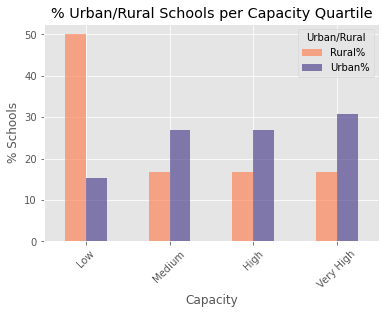

In [65]:
bar_data[['Rural%', 'Urban%']].plot(kind='bar', color=['coral','darkslateblue'], alpha=0.65)
plt.xticks((0,1,2,3),('Low', 'Medium', 'High', 'Very High'), rotation=45)
plt.xlabel('Capacity')
plt.ylabel('% Schools')
plt.title('% Urban/Rural Schools per Capacity Quartile')

## Methodology <a name="methodology"></a>

In this project we will limit our analysis to the North Yorkshire county region (which covers the administrative areas of **York** and **North Yorkshire**.

In the first step, we have collected and cleaned the required data - geographic data, population distribution within the region, school location (according to Foursquare categorisation) and capacity information and rural/urban categorisation of schools. We have restricted the data to look purely at high schools (age range 11-18). We have also examined the urban/rural data feature to determine whether it should be included in the data analysis.

The second step will be to perform some data visualisation to identify any obvious trends. This will include visualising population distribution by heat map, and also looking at whether there is any obvious school shortage from plotting school capacity information by location.

In the third and final step, we will analyse the total number high school age students associated with each school (by assuming that each student attends the nearest school), and calculate the average distance pupils must travel to each school. By comparing the results of these 2 analyses we will propose the most impactful locations to site a new school. This should then be a starting point for a more detailed analysis of these areas.

## Analysis <a name="analysis"></a>

Let's start with some exploratory data analysis, to see whether any obvious trends can be derived from the raw data.

### Relationship Between Capacity and Location

We will plot a histogram to visualise distribution of capacity of existing schools.

Text(0.5, 1.0, 'Histogram of Current School Capacity %')

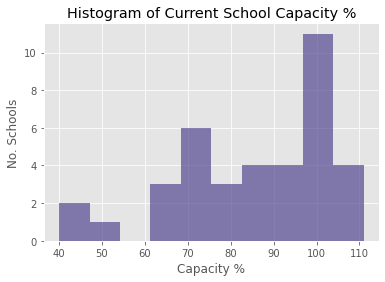

In [66]:
Schools_merged['Capacity%'].plot(kind='hist', alpha=0.65, color='darkslateblue')
plt.xlabel('Capacity %')
plt.ylabel('No. Schools')
plt.title('Histogram of Current School Capacity %')

Using the histogram we will now allocate the schools to capacity 'bins' according to the following:
- Capacity < 60% - Low
- Capacity 60-85% - Medium
- Capacity 85-95% - High
- Capacity > 95% - Very High

In [67]:
Schools_merged['Capacity'] = pd.cut(Schools_merged['Capacity%'], bins=[0,60,85,95,120], labels=['Low', 'Medium', 'High', 'Very High'])
Schools_merged.drop(['CapacityQuartile'], axis=1, inplace=True)
Schools_merged.head()

,School,SchoolLatitude,SchoolLongitude,LSOA_Code,LSOA_Name,Urban/Rural,SchoolCapacity,NumberOfPupils,Capacity%,Capacity
0,Manor CE School,53.975129,-1.136420,E01013422,York 011B,Urban,1001.0,1106.0,110.49,Very High
1,Joseph Rowntree School,53.997754,-1.070044,E01013407,York 004B,Urban,1328.0,1296.0,97.59,Very High
2,York High School,53.948905,-1.129683,E01013447,York 018E,Urban,991.0,732.0,73.86,Medium
3,Archbishop Holgate's School,53.952918,-1.041007,E01013402,York 014B,Urban,1900.0,1622.0,85.37,High
4,The Mount School,53.952935,-1.099325,E01013417,York 017E,Urban,461.0,199.0,43.17,Low


We will then plot the schools on a Folium map, with colour according to their Capacity 'bin' and size according to the school's rural/urban categorisation.

In [68]:
map_schools2 = folium.Map(location=[latitude, longitude], zoom_start=9)

colourdict = {'Low': 'blue', 'Medium': 'green', 'High': 'orange', 'Very High': 'red'}
sizedict = {'Rural': 2, 'Urban': 1}

# instantiate a feature group for the schools in the dataframe
schools2 = folium.map.FeatureGroup()

# loop through the schools and add each to the feature group
for lat, lng, label, cap, ur in zip(Schools_merged['SchoolLatitude'], Schools_merged['SchoolLongitude'], Schools_merged['School'], Schools_merged['Capacity'], Schools_merged['Urban/Rural']):
    schools2.add_child(
        folium.features.CircleMarker(
            [lat, lng],
            radius=5*sizedict[ur], 
            color=colourdict[cap],
            fill=True,
            popup=label,
            fill_color=colourdict[cap],
            fill_opacity=1
        )
    )

# add schools to map
map_schools2.add_child(schools2)


We can see that there is no clear geographical pattern as to where schools with the most capacity strain are located. It is clear that a greater proportion of urban schools have capacity utilization > 85%, but there are also several rural schools is the highest capacity group. 

It is also interesting to note that particularly within the York area, there are schools with limited or no spare capacity very near to schools with reasonable spare capacity. It is suggested that this may be due to perceived standard of the school (e.g. OFSTED rating), and this could be the subject of a future analysis.

From the analysis so far, it is clear that location and capacity alone are not enough to identify the location most in need of a new school.

### Visualisation of Population Distribution

We will visualise the population in the region with the use of a heat map. This can then be compared with the previous capacity analysis to identify any obvious patterns.

In [69]:
map_pop = folium.Map(location=[latitude, longitude], zoom_start = 9) 

hm_df = LSOA_pop.loc[:,('Latitude','Longitude','High School Pop.')]
hm_df['Latitude'] = hm_df['Latitude'].astype(float)
hm_df['Longitude'] = hm_df['Longitude'].astype(float)

# List comprehension to make out list of lists
heat_data = [[row['Latitude'],row['Longitude']] for index, row in hm_df.iterrows()]

# Plot it on the map
HeatMap(heat_data, min_opacity=0.5, blur=20).add_to(map_pop)

# Display the map
map_pop

When compared with map of school locations and their associated capacity status, the population distribution generally aligns well as would be expected. We can see that areas with higher population density, also generally have a higher density of schools. Although there a no obvious gaps, there are some areas that could warrant further investigation. The areas of high population density around Harrogate and Scaraborough, visually look to have slightly lower school provision relative to the population. We will keep this in mind as we progress with the analysis.

### Total High School Age Population Associated with Each School

We will now move on to our third any final step in the data analysis. To carry out this analysis, we will make the assumption that each student should attend the nearest high school to their address. This is a reasonable assumption as it is typically how school catchment areas are designed, however, it is not always the case as when schools have spare capacity they are able to accept students from locations outside of their area.

Assuming that each high school age person attends their nearest school, we can calculate the school each pupil will attend based on the nearest school to each LSOA.

We have the latitude/longitude of each LSOA, and each school - the nearest school for each LSOA can therefore be calculated. Assuming the world is a sphere, **we can calculate the shortest distance between 2 points on the Earth's surface using the Haversine equation.**

First we define a function which uses the **Haversine equation** to return the distance between 2 points.

In [70]:
from math import radians, cos, sin, asin, sqrt
def dist(lat1, long1, lat2, long2):
    """
    Calculate the great circle distance between two points 
    on the earth (specified in decimal degrees)
    """
    # convert decimal degrees to radians 
    lat1, long1, lat2, long2 = map(radians, [lat1, long1, lat2, long2])
    # haversine formula 
    dlon = long2 - long1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a)) 
    # Radius of earth in kilometers is 6371
    km = 6371* c
    return km

We then define a function apply the function above to each LSOA and school combination, and to return the school with the minimum distance for each LSOA. 

In [71]:
def find_nearest(lat, long):
    distances = Schools_merged.apply(
        lambda row: dist(lat, long, row['SchoolLatitude'], row['SchoolLongitude']), 
        axis=1)
    return Schools_merged.loc[distances.idxmin(), 'School']

We can now apply the 2 functions and append the result into the population dataframe.

In [72]:
LSOA_pop['School'] = LSOA_pop.apply(
    lambda row: find_nearest(row['Latitude'], row['Longitude']), 
    axis=1)
LSOA_pop.head()

,LSOA Code,LSOA Name,Latitude,Longitude,MSOA Code,MSOA Name,Total Pop.,High School Pop.,School
0,E01013335,York 012A,53.961965,-1.128547,E02002783,Acomb,"1,626",164,York High School
1,E01013336,York 012B,53.957848,-1.128970,E02002783,Acomb,"1,548",124,York High School
2,E01013337,York 012C,53.960715,-1.136146,E02002783,Acomb,"1,721",154,York High School
3,E01013338,York 012D,53.966206,-1.125190,E02002783,Acomb,"2,389",219,Manor CE School
4,E01013339,York 012E,53.967457,-1.132669,E02002783,Acomb,"1,596",144,Manor CE School


We will now group the population by school, join with the capacity data & sort in descending order.

In [73]:
pps = LSOA_pop.groupby('School', as_index=False)['High School Pop.'].sum()
pps = pd.merge(left=pps, right=Schools_merged[['School','Capacity']], on='School', how='left')
pps_sorted = pps.sort_values(by=['High School Pop.'], ascending=True).reset_index(drop=True)
pps_sorted = pps_sorted.set_index('School')
pps_sorted.head()

,High School Pop.,Capacity
School,,
All Saints RC School,346,Very High
York Steiner School,477,Medium
Mowbray School,597,Very High
Millthorpe School,622,Very High
Queen Margarets School,675,Medium


We can now plot a bar chart which shows the schools with the highest number of students in it's catchment area. We will also retain the capacity 'bin' classification from earlier.

Text(0.5, 1.0, 'No. Students per School')

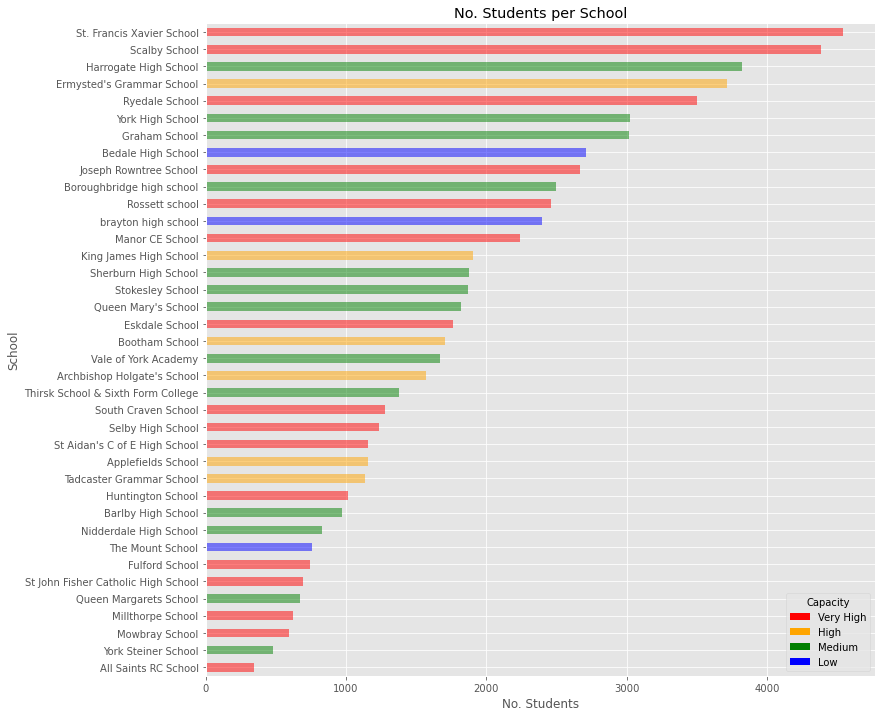

In [74]:
from matplotlib.patches import Patch

# define colour library
colours = {'Very High':'Red', 'High':'Orange', 'Medium':'Green', 'Low':'Blue'}

pps_sorted.plot(
        kind='barh', alpha=0.5, figsize=(12,12), color=[pps_sorted['Capacity'].replace(colours)]
).legend(
    [
        Patch(facecolor=colours['Very High']),
        Patch(facecolor=colours['High']),
        Patch(facecolor=colours['Medium']),
        Patch(facecolor=colours['Low'])
    ], ["Very High", "High", "Medium", "Low"], title='Capacity'
)
        
plt.xlabel('No. Students')
plt.title('No. Students per School')

We can see from this that there is large disparity regarding the number of students for which each school is the nearest, ranging from less than 500 to more than 4000. There is no clear correlation between current capacity status and the number of students for which the schools is the nearest, but we can see that 4 of the 5 top schools are in the 'high' or 'very high' capacity groups.

Finally, we will **rank** each school based on the number of pupils associated with it. All Saints RC schools is the nearest school for only 346 students so this is the highest ranked school, whereas St Francis Xavier school is the nearest school for the highest number of students, so this has the lowest rank. This will be used later.

In [75]:
pps_sorted['Rank'] = list(range(1,39))
pps_sorted = pps_sorted.reset_index()
pps_sorted.head()

,School,High School Pop.,Capacity,Rank
0,All Saints RC School,346,Very High,1
1,York Steiner School,477,Medium,2
2,Mowbray School,597,Very High,3
3,Millthorpe School,622,Very High,4
4,Queen Margarets School,675,Medium,5


### Analysis of Average Distance of Pupils from Nearest School

Now we can do a similar analysis for the average distance students must travel to each school. It is beneficial for students to minimise the time spent travelling to & from school, to maximise learning effectiveness, therefore a higher average distance travelled may be indicative of a good location to investigate further for building a new school.

First, we will join the population and school data.

In [76]:
LSOA_pop2 = pd.merge(left=LSOA_pop, right=Schools_merged, left_on='School', right_on='School', how='left')
LSOA_pop2.head()

,LSOA Code,LSOA Name,Latitude,Longitude,MSOA Code,MSOA Name,Total Pop.,High School Pop.,School,SchoolLatitude,SchoolLongitude,LSOA_Code,LSOA_Name,Urban/Rural,SchoolCapacity,NumberOfPupils,Capacity%,Capacity
0,E01013335,York 012A,53.961965,-1.128547,E02002783,Acomb,"1,626",164,York High School,53.948905,-1.129683,E01013447,York 018E,Urban,991.0,732.0,73.86,Medium
1,E01013336,York 012B,53.957848,-1.128970,E02002783,Acomb,"1,548",124,York High School,53.948905,-1.129683,E01013447,York 018E,Urban,991.0,732.0,73.86,Medium
2,E01013337,York 012C,53.960715,-1.136146,E02002783,Acomb,"1,721",154,York High School,53.948905,-1.129683,E01013447,York 018E,Urban,991.0,732.0,73.86,Medium
3,E01013338,York 012D,53.966206,-1.125190,E02002783,Acomb,"2,389",219,Manor CE School,53.975129,-1.136420,E01013422,York 011B,Urban,1001.0,1106.0,110.49,Very High
4,E01013339,York 012E,53.967457,-1.132669,E02002783,Acomb,"1,596",144,Manor CE School,53.975129,-1.136420,E01013422,York 011B,Urban,1001.0,1106.0,110.49,Very High


We will then define another function to use the Haversine equation again, and then use this to calculate the distance between each LSOA and it's nearest school (as calculated previously).

In [77]:
def haversine(lon1, lat1, lon2, lat2):
    """
    Calculate the great circle distance between two points 
    on the earth (specified in decimal degrees)
    """
    # convert decimal degrees to radians 
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])
    # haversine formula 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a)) 
    # Radius of earth in kilometers is 6371
    km = 6371* c
    return km

In [78]:
LSOA_pop2['Distance'] = [haversine(LSOA_pop2.Longitude[i], LSOA_pop2.Latitude[i], LSOA_pop2.SchoolLongitude[i], LSOA_pop2.SchoolLatitude[i]) for i in range(len(LSOA_pop2))]
LSOA_pop2['Distance'] = LSOA_pop2['Distance'].round(decimals=2)
LSOA_pop2.head()

,LSOA Code,LSOA Name,Latitude,Longitude,MSOA Code,MSOA Name,Total Pop.,High School Pop.,School,SchoolLatitude,SchoolLongitude,LSOA_Code,LSOA_Name,Urban/Rural,SchoolCapacity,NumberOfPupils,Capacity%,Capacity,Distance
0,E01013335,York 012A,53.961965,-1.128547,E02002783,Acomb,"1,626",164,York High School,53.948905,-1.129683,E01013447,York 018E,Urban,991.0,732.0,73.86,Medium,1.45
1,E01013336,York 012B,53.957848,-1.128970,E02002783,Acomb,"1,548",124,York High School,53.948905,-1.129683,E01013447,York 018E,Urban,991.0,732.0,73.86,Medium,1.00
2,E01013337,York 012C,53.960715,-1.136146,E02002783,Acomb,"1,721",154,York High School,53.948905,-1.129683,E01013447,York 018E,Urban,991.0,732.0,73.86,Medium,1.38
3,E01013338,York 012D,53.966206,-1.125190,E02002783,Acomb,"2,389",219,Manor CE School,53.975129,-1.136420,E01013422,York 011B,Urban,1001.0,1106.0,110.49,Very High,1.23
4,E01013339,York 012E,53.967457,-1.132669,E02002783,Acomb,"1,596",144,Manor CE School,53.975129,-1.136420,E01013422,York 011B,Urban,1001.0,1106.0,110.49,Very High,0.89


We can now calculate the average distance pupils must travel to each school, and plot the results on a bar chart.

In [79]:
dps = LSOA_pop2.groupby('School', as_index=False)['Distance'].mean()
dps = pd.merge(left=dps, right=Schools_merged[['School','Capacity']], on='School', how='left')
dps_sorted = dps.sort_values(by=['Distance'], ascending=True).reset_index(drop=True)
dps_sorted = dps_sorted.set_index('School')
dps_sorted.head()

,Distance,Capacity
School,,
All Saints RC School,0.410000,Very High
Millthorpe School,0.702000,Very High
York Steiner School,0.717500,Medium
Applefields School,0.781111,High
Vale of York Academy,0.848182,Medium


Text(0.5, 0, 'Distance (km)')

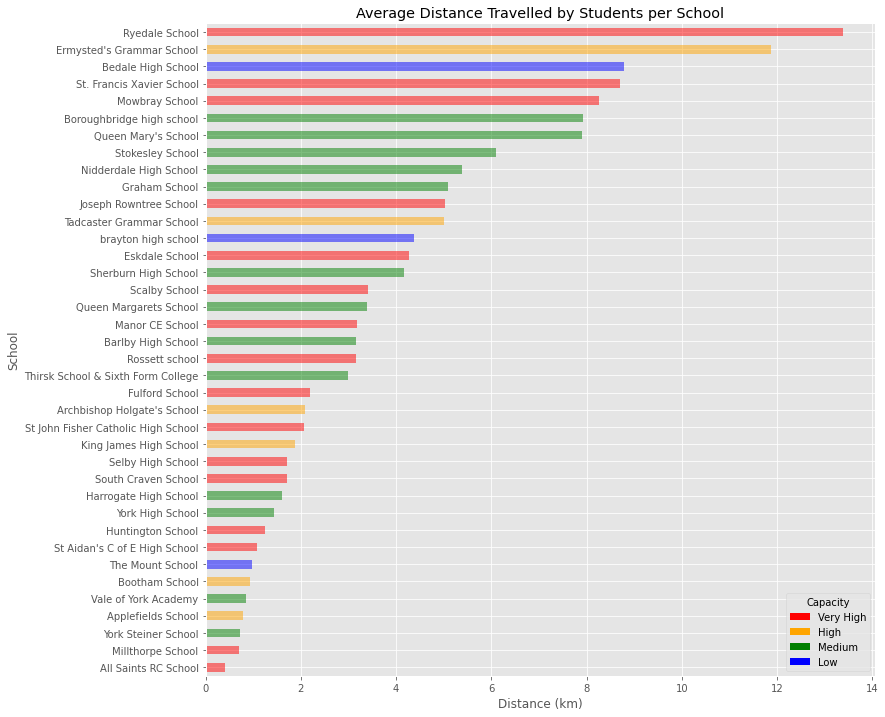

In [80]:
from matplotlib.patches import Patch

# define colour library
colours = {'Very High':'Red', 'High':'Orange', 'Medium':'Green', 'Low':'Blue'}

dps_sorted.plot(
        kind='barh', alpha=0.5, figsize=(12,12), color=[dps_sorted['Capacity'].replace(colours)]
).legend(
    [
        Patch(facecolor=colours['Very High']),
        Patch(facecolor=colours['High']),
        Patch(facecolor=colours['Medium']),
        Patch(facecolor=colours['Low'])
    ], ["Very High", "High", "Medium", "Low"], title='Capacity'
)

plt.title('Average Distance Travelled by Students per School')
plt.xlabel('Distance (km)')

The first thing to note from this analysis is that the average distance travelled for all of the schools is not particularly high (the maximum is still less than 14 km). This suggests that the distribution of the current schools is reasonably good. However, we will still focus on the schools where the average distance travelled is highest, as these are the more rural schools, which suggests a greater variation in the distance travelled, and therefore it is likely that a number of students must still travel a significant distance to reach their nearest high school.

Similarly to the previous analysis, there is no clear correlation between current capacity status and average distance travelled, but 4 of the 5 schools requiring students to travel the furthest are also in the 2 top capacity groups.

Again, we will **rank** each school based on the average distance travelled by students. All Saints RC schools is the school where students have to travel the shortest distance, so this is the highest ranked school, whereas Ryedale School requires students to travel the furthest, so this has the lowest rank.

In [81]:
dps_sorted['Rank'] = list(range(1,39))
dps_sorted = dps_sorted.reset_index()
dps_sorted.head()

,School,Distance,Capacity,Rank
0,All Saints RC School,0.410000,Very High,1
1,Millthorpe School,0.702000,Very High,2
2,York Steiner School,0.717500,Medium,3
3,Applefields School,0.781111,High,4
4,Vale of York Academy,0.848182,Medium,5


### Comparison Between Average Distance Travelled to School & Number of Students Allocated to Each School

We have now ranked each school best to worst based on:
1. The **number of pupils** allocated to the school (based on nearest school)
2. The **average distance** students must travel to their nearest school

In the final stage of this analysis we will compare the ranking against each of these 2 factors to see if there is any correlation. If there is found to be correlation, then schools with a **poor ranking in both** would be an appropriate starting point for further analsyis into where a new school should be sited.

Firstly, we will create a datframe which contains both ranks for each school.

In [82]:
summary = pd.merge(left=pps_sorted[['School','Rank']], right=dps_sorted[['School','Rank']], left_on='School', right_on='School', how='left')
summary = summary.rename(columns={'Rank_x':'StudentsRank', 'Rank_y':'DistanceRank'})
summary.head()

,School,StudentsRank,DistanceRank
0,All Saints RC School,1,1
1,York Steiner School,2,3
2,Mowbray School,3,34
3,Millthorpe School,4,2
4,Queen Margarets School,5,22


We will now create a scatter plot of the 2 ranks, and will use numpy's polyfit function (1D) to create a linear regression line which will be added to the plot.

In [83]:
d = np.polyfit(summary['StudentsRank'],summary['DistanceRank'],1)
f = np.poly1d(d)
summary['reg'] = f(summary['StudentsRank'])

Text(0, 0.5, 'School Rank - Average Distance Travelled')

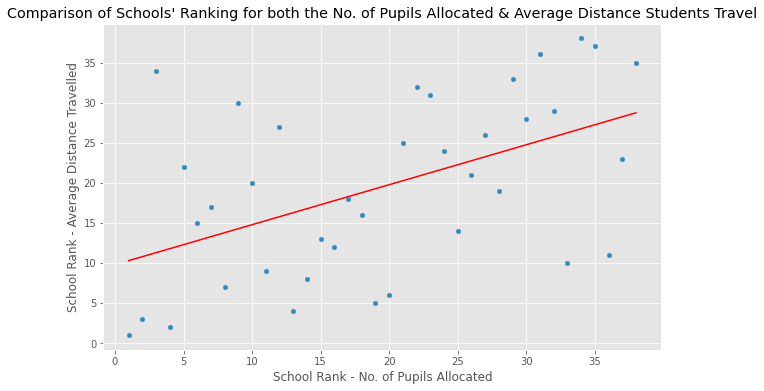

In [84]:
ax = summary.plot(kind='scatter', figsize=(10,6), x='StudentsRank', y='DistanceRank')
summary.plot(x='StudentsRank', y='reg', color='Red', ax=ax, legend=None)
ax.set_title("Comparison of Schools' Ranking for both the No. of Pupils Allocated & Average Distance Students Travel")
ax.set_xlabel('School Rank - No. of Pupils Allocated')
ax.set_ylabel('School Rank - Average Distance Travelled')

We can see that although the data is well spread, there is clear correlation, that schools with a greater number of pupils allocated, also have a tendency to be those where the average distance students must travel is greater.

We will focus on the locations of 3 schools which are in the **bottom 5** for both number of students, and average distance travelled. These are **St. Francis Xavier School**, **Ermysted's Grammar School** and **Ryedale School**. We will plot these on a map to view their location.

In [85]:
map_schools3 = folium.Map(location=[latitude, longitude], zoom_start=9)

clrs = ['red' if (x == 'Ryedale School' or x == 'St. Francis Xavier School' or x == "Ermysted's Grammar School") else 'black' for x in Schools_merged['School']]
sizedict = {'Rural': 2, 'Urban': 1}

# instantiate a feature group for the schools in the dataframe
schools3 = folium.map.FeatureGroup()

# loop through the schools and add each to the feature group
for lat, lng, label, ur, clr in zip(Schools_merged['SchoolLatitude'], Schools_merged['SchoolLongitude'], Schools_merged['School'], Schools_merged['Urban/Rural'], clrs):
    schools3.add_child(
        folium.features.CircleMarker(
            [lat, lng],
            radius=5*sizedict[ur], 
            color=clr,
            fill=True,
            popup=label,
            fill_color=clr,
            fill_opacity=1
        )
    )

# add schools to map
map_schools3.add_child(schools3)

The 3 locations in <span style="color:red">**red**</span> are those identified as being in the bottom 5 for both number of students allocated, and average distance travelled. We can see from the size of the marker, that 2 are rural schools (large marker), and 1 is an urban school. Their associated locations (nearest towns), as can be seen on the map, are Richmond, Helmsley and Skipton.

It is noted that these 3 schools do not have others in the vicinity, and therefore it is unlikely that students have many alternative options. Additionally, they all have current capacity utilisation higher than 85% (in the top 2 groups), and 2 of the 3 have capacity utilisation higher than 95%  This further supports the suggestion that these three areas would be good candidates for a new school.

This concludes the analysis. We have identified 3 areas which represent a good starting point for further investigation. The 3 areas currently have schools without much spare capacity, the number of pupils for which that school is the nearest is very high & the average distance students travel to the schools is also significant.


## Results and Discussion <a name="results"></a>

Schools were split according to their current capacity utilization and plotted geographically, but there was found to be no clear pattern between the location of a school and its capacity status, therefore on its own, this is not a valid predictor. Schools were also found to align well with population distribution (with more schools in areas of higher population density), although the 2 areas of Scarborough and Harrogate were identified as possible areas with high population density, and not the same density of schools.

Analysis of the number of students allocated to each school allowed schools with a very high student catchment to be identified. Several of these were also shown to have a high current capacity utilization. Similarly, the average distance students travel to each school, also allowed schools supporting a very large geographical area to be identified.
There was clear correlation between schools with a very high student catchment and those supporting a large geographical area. Three schools were focused on as ranking in the bottom 5 for both analyses. This analysis suggests that these are schools situated in areas which are struggling from a lack of school provision.

The local areas for the 3 schools previously identified (Richmond, Helmsley and Skipton) meet several of the criteria for requiring a new school. Analysis of existing schools in these areas show that they already have high capacity utilization, so cannot accept an increase in student numbers, represent the nearest school for a very high number of high school age students, and the average distance travelled by students to reach the existing schools is well above average. These areas are therefore proposed as the most worthy of further investigation as to which would most benefit from a new school. 

Although the factors described above indicate that the existing school provision in these three areas may be insufficient, and therefore benefit could be derived from opening a new school, subsequent analysis would be needed to determine exactly where a new school should be situated. The analysis in this project has focused on the existing schools (status and location), but a new school should clearly not be sited in the exact location of an existing school. Therefore, a follow up analysis should focus on where (within the areas identified) a new school would result in the maximum positive impact on number of students allocated per school and on average distance travelled by students. 

Although this analysis has provided a basic understanding of schools in the area, and allowed potential locations for a new school to be identified, there are also some points which have not been considered, which could impact these results. A significant point of interest is that, particularly within the York area, there are schools with limited or no spare capacity very near to schools with reasonable spare capacity. This casts some level of doubt on the assumption that each student attends the nearest school, and it is hypothesized that some of this variation may be due to perceived standard of the school (e.g. OFSTED rating). In a more follow-up analysis this may need to be included as a data feature.

The analysis completed in this project is relatively simplistic, and to build on this several other features could be included. The population growth rate has not been considered within this analysis, and therefore is assumed to be consistent across all areas of the region. This is unlikely to be the case, as it growth rate is typically higher in urban areas (although this is likely to be affected by Covid-19 as there has been an increase in relocation to more rural areas). A subsequent analysis could also include the average travelling time to the nearest school as well as average travelling distance, as this would likely to provide additional insights. Although travelling distances are typically much further in rural areas, the difference in time is likely reduced due to higher traffic levels in urban areas. Inclusion of school type (State/Independent) is also recommended in a future analysis as complete coverage of State schools is require regardless of nearby Independent school locations.

## Conclusion <a name="conclusion"></a>

The purpose of this project was to identify the locations within the North Yorkshire county region most in need of a new high school. By visualizing the population distribution of the region and the capacity status of existing high schools in the region, it was clear that the existing school locations provide good coverage of the region and align well with the population distribution. By further analysing existing schools on 2 factors – the number of students allocated to them, and the average distance students travel to attend the school, three schools were identified as performing poorly in both areas, suggesting that existing school provision in these areas is not sufficient. The areas surrounding these schools are proposed as starting points for further investigation as to where would be most appropriate to site a new high school.

A final decision on optimum location for a new school would require significant further analysis by North Yorkshire county council, considering additional factors such as education standard of existing schools, transport links and localized rates of population growth.